# Machine Learning Tester

This notebook is a scaffolding to test multiple ML libraries from SKlearn toolkit

In [1]:
# Imports
import pandas as pd
import numpy as np
import hvplot.pandas
import matplotlib.pyplot as plt
from pathlib import Path
from finta import TA
from sklearn.preprocessing import StandardScaler
from pandas.tseries.offsets import DateOffset
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

# Import a new classifiers from SKLearn
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import BernoulliNB
from imblearn.over_sampling import RandomOverSampler

from utils.utils import epoch_to_datetime,make_label

import warnings
warnings.filterwarnings('ignore')


In [2]:
# Define data source
sources = [
    {"provider":"cryptocompare","label":"BTC","path":Path('data/BTC_historical_price.csv')},
    {"provider":"cryptocompare","label":"DAI","path":Path('data/DAI_historical_price.csv')},
    {"provider":"cryptocompare","label":"ETH","path":Path('data/ETH_historical_price.csv')},
    {"provider":"cryptocompare","label":"USDC","path":Path('data/USDC_historical_price.csv')},
    {"provider":"cryptocompare","label":"USDT","path":Path('data/USDT_historical_price.csv')},
    {"provider":"kucoin","label":"sUSD/USDT","path":Path('data/sUSD_USDC_ku_historical_price.csv')}
]

# Labeling Parameters
periods = [1,2,4,8]
# periods = [4]
factors = [2]
# factors = [0.8]
std_window = 24*42 # focus on the volatility of the past 42 days, why 42, ask Kevin L.

# Define tuning permutations

# Tune models by evaluationg several training dataset sizes
# training_dataset_months = [6]
training_dataset_months = [1,3,5]

# Tune models by evaluationg several short SMA window sizes
# short_window_sizes = [3]
short_window_sizes = [1,2,3,4,6]

# Tune models by evaluationg several long SMA window sizes
long_window_sizes = [42,60,180,252]
# long_window_sizes = [42]

# define a dictionary of models to train
alternate_models = {}

# Initiate the model instances

alternate_models['SVC'] = {
        "model": svm.SVC()
    }
alternate_models['LogisticRegression'] = {
        "model": LogisticRegression()
    }
# alternate_models['DecisionTreeClassifier'] = {
#         "model": DecisionTreeClassifier()
#     }
# alternate_models['GradientBoostingClassifier'] = {
#         "model": GradientBoostingClassifier()
#     }
alternate_models['AdaBoostClassifier'] = {
        "model": AdaBoostClassifier()
    }
alternate_models['GaussianNB'] = {
        "model": GaussianNB()
    }

## DataPrep

### CryptoCompare Hourly DataSets

In [3]:
def get_cryptocompare_data(file_path):
    """ Prep the data by creating a simple ohlcv df, inddex Time(UTC)
    """
    df = pd.read_csv(
        file_path,
        infer_datetime_format=True,
        parse_dates=True,
        index_col='Time (UTC)'
    )
    df.drop(columns=['volume_from'], inplace = True)
    df.rename(columns = {'volume_to':'volume'}, inplace = True)
    return df

### KuCoin sUSD/USDT pair dataset

In [4]:
def get_kucoin_data(file_path):
    """ Prep the data by creating a simple ohlcv df, inddex Time(UTC)
    """    
    df = pd.read_csv(
        file_path,
        infer_datetime_format=True,
        parse_dates=True,
    )
    df['epoch'] = df['epoch']/1000  # from epoch in ms to epoch in seconds
    df['Time (UTC)'] = df['epoch'].apply(epoch_to_datetime) 
    df.drop(columns=['epoch'], inplace = True)
    df.set_index('Time (UTC)', inplace = True)
    return df

In [5]:
def add_engineered_features(df, fast_sma_window, slow_sma_window):
    """ assumes that the df is a standard simlpe ohlcv df
    
        Engineered features include:
        * fast SMA for close
        * slow SMA for close
        * fast SMA for volume
        * slow SMA for volume
            
    """
    df['SMA_fast_close'] = df['close'].rolling(window=fast_sma_window).mean()
    df['SMA_slow_close'] = df['close'].rolling(window=slow_sma_window).mean()
    df['SMA_fast_volume'] = df['volume'].rolling(window=fast_sma_window).mean()
    df['SMA_slow_volume'] = df['volume'].rolling(window=slow_sma_window).mean()
    # df['Bollinger Bands'] = TA.BBANDS(df.drop(columns=['volume'],MA=TA.KAMA(100))
    # df['Donchian Channel'] = TA.DO(df)
    # df['Directional Movement Indicator'] = TA.DMI(df)
    df['Mass Index'] = TA.MI(df)
    # df['Adaptive Price Zone'] = TA.APZ(df) # either use BBANDS or APZ
    return df

In [6]:
def add_class_labels(df, std_window, factor, period):
    """ a function that expects the fully hydrated df as input in order to have maximum flexibility in implementing logic to calculate class labels
    """
    # calculate rolling standard deviation for set window size
    df['sUSD/USDT_std']=df['sUSD/USDT_close'].rolling(std_window).std()  # engineered data

    # calculate triggering offset
    df['sUSD/USDT_offset'] = df['sUSD/USDT_std'] * factor 

    # created future price column
    df['sUSD/USDT_future'] = df['sUSD/USDT_close'].shift(period*-1)

    # make label
    df['y'] = df.apply(
                make_label,
                axis=1,
                current_price_col='sUSD/USDT_close',
                future_price_col='sUSD/USDT_future',
                offset_col = 'sUSD/USDT_offset' )
    display(df['y'].dropna().value_counts())    
    return df


### Evaluate Models

In [7]:

# create helper methods to facilitate assessing permutations


def create_train_test_datasets(months, df):
    """ calculate the trainind start and end based on the given df.  df is assumed to have a column y that denotes the class labels
    """
    
    # separate df into X and y
    df = df.dropna()
    y = df['y']
    X = df.drop(columns=['y'])
    
    # separate dataset into training and testing dataset based on months
    training_begin = X.index.min()
    training_end = X.index.min() + DateOffset(months=months)

    # create the training features dataset X_train and training classigication labels y_train for the training timeframe
    X_train = X.loc[training_begin:training_end]
    y_train = y.loc[training_begin:training_end]

    # create the testing features dataset X_test and testing classigication labels y_test following the training timeframe
    X_test = X.loc[training_end+DateOffset(hours=1):]
    y_test = y.loc[training_end+DateOffset(hours=1):]
    
    # Use StandardScaler to scale the data.
    # Scale the features DataFrames

    # Create a StandardScaler instance
    scaler = StandardScaler()

    # Apply the scaler model to fit the X-train data
    X_scaler = scaler.fit(X_train)

    # Transform the X_train and X_test DataFrames using the X_scaler
    X_train_scaled = X_scaler.transform(X_train)
    X_test_scaled = X_scaler.transform(X_test)  
    return X_train_scaled, y_train, X_test_scaled, y_test, X_scaler

    
def backtest_model(model_name, df):
    
    # Backtest model performance
    display(df)

    # Add the strategy returns to the DataFrame
    df['Strategy Returns'] = (df['Actual Returns'] * df['y_prediction'])

    # Calculate the cumulative stategy return
    df['strategy_cum_return'] = (1 + df["Strategy Returns"]).cumprod()

    # Calculate the actual stategy return
    df['actual_cum_return'] = (1 + df["Actual Returns"]).cumprod()

    # Plot the actual returns versus the strategy returns
    cum_actual_strategy_plot = df[['actual_cum_return','strategy_cum_return']].plot(
        figsize=(15,7),
        title=f'Cumulative Returns Actual vs Strategy for model {model_name}'
    )
    # save plot
    # cum_actual_strategy_plot.figure.savefig(f'images/{model_name}_actual_vs_strategy_cum_returns.png', bbox_inches='tight')
    
    return df

 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      1
 1      1
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
 1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(1)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        40
           0       0.99      1.00      1.00     11509
           1       0.00      0.00      0.00        32

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.99      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    672
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    672
-1    672
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(1)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        64
           0       0.99      1.00      0.99     11465
           1       0.00      0.00      0.00        52

    accuracy                           0.99     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.98      0.99      0.99     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    671
-1      2
Name: y, dtype: int64
value counts after resampling: 
 0    671
-1    671
Name: y, dtype: int64
# of y_test: 11581    # of predictions: 11581


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(1)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        96
           0       0.98      1.00      0.99     11402
           1       0.00      0.00      0.00        83

    accuracy                           0.98     11581
   macro avg       0.33      0.33      0.33     11581
weighted avg       0.97      0.98      0.98     11581

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    670
 1      2
-1      1
Name: y, dtype: int64
value counts after resampling: 
 0    670
 1    670
-1    670
Name: y, dtype: int64
# of y_test: 11579    # of predictions: 11579


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(1)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       156
           0       0.97      1.00      0.99     11273
           1       0.00      0.00      0.00       150

    accuracy                           0.97     11579
   macro avg       0.32      0.33      0.33     11579
weighted avg       0.95      0.97      0.96     11579

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-03-12 08:00:00+00:00,0,0,-0.002253
2021-03-12 09:00:00+00:00,0,0,-0.000310
2021-03-12 10:00:00+00:00,0,0,-0.000099
2021-03-12 11:00:00+00:00,0,0,0.000000
2021-03-12 12:00:00+00:00,0,0,0.000133
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    2125
-1       8
 1       5
Name: y, dtype: int64
value counts after resampling: 
 0    2125
-1    2125
 1    2125
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(3)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        33
           0       0.99      1.00      1.00     10055
           1       0.00      0.00      0.00        28

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.99      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    2116
-1      14
 1       8
Name: y, dtype: int64
value counts after resampling: 
 0    2116
-1    2116
 1    2116
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(3)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        51
           0       0.99      1.00      1.00     10021
           1       0.00      0.00      0.00        44

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.98      0.99      0.99     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    2107
-1      16
 1      15
Name: y, dtype: int64
value counts after resampling: 
 0    2107
-1    2107
 1    2107
Name: y, dtype: int64
# of y_test: 10116    # of predictions: 10116


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(3)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        82
           0       0.99      1.00      0.99      9966
           1       0.00      0.00      0.00        68

    accuracy                           0.99     10116
   macro avg       0.33      0.33      0.33     10116
weighted avg       0.97      0.99      0.98     10116

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    2066
 1      41
-1      31
Name: y, dtype: int64
value counts after resampling: 
 0    2066
 1    2066
-1    2066
Name: y, dtype: int64
# of y_test: 10114    # of predictions: 10114


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(3)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       126
           0       0.98      1.00      0.99      9877
           1       0.00      0.00      0.00       111

    accuracy                           0.98     10114
   macro avg       0.33      0.33      0.33     10114
weighted avg       0.95      0.98      0.96     10114

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-05-12 08:00:00+00:00,0,0,0.002748
2021-05-12 09:00:00+00:00,0,0,0.001558
2021-05-12 10:00:00+00:00,0,0,0.000477
2021-05-12 11:00:00+00:00,0,0,-0.009034
2021-05-12 12:00:00+00:00,0,0,-0.000593
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(1)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(1)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(1)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(1)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(2)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(2)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(2)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(2)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(3)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(3)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(3)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(3)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(4)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(4)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(4)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(4)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(6)-lw(42) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(6)-lw(60) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(6)-lw(180) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


 0    13193
-1       41
 1       33
Name: y, dtype: int64

value counts before resampling: 
 0    3585
-1      11
 1       6
Name: y, dtype: int64
value counts after resampling: 
 0    3585
-1    3585
 1    3585
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f1-tr(5)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        30
           0       0.99      1.00      1.00      8595
           1       0.00      0.00      0.00        27

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.99      0.99      0.99      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13150
-1       65
 1       52
Name: y, dtype: int64

value counts before resampling: 
 0    3576
-1      17
 1       9
Name: y, dtype: int64
value counts after resampling: 
 0    3576
-1    3576
 1    3576
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f2-tr(5)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        48
           0       0.99      1.00      0.99      8561
           1       0.00      0.00      0.00        43

    accuracy                           0.99      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.98      0.99      0.98      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    13086
-1       98
 1       83
Name: y, dtype: int64

value counts before resampling: 
 0    3567
-1      19
 1      16
Name: y, dtype: int64
value counts after resampling: 
 0    3567
-1    3567
 1    3567
Name: y, dtype: int64
# of y_test: 8652    # of predictions: 8652


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000



                        SVC-f4-tr(5)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00        79
           0       0.98      1.00      0.99      8506
           1       0.00      0.00      0.00        67

    accuracy                           0.98      8652
   macro avg       0.33      0.33      0.33      8652
weighted avg       0.97      0.98      0.97      8652

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 15:00:00+00:00,0,0,0.000000
2022-07-07 16:00:00+00:00,0,0,0.000017
2022-07-07 17:00:00+00:00,0,0,0.000000


 0    12958
-1      157
 1      152
Name: y, dtype: int64

value counts before resampling: 
 0    3525
 1      43
-1      34
Name: y, dtype: int64
value counts after resampling: 
 0    3525
 1    3525
-1    3525
Name: y, dtype: int64
# of y_test: 8650    # of predictions: 8650


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000



                        SVC-f8-tr(5)-sw(6)-lw(252) classification report: 
                        ---------------------------------------------------------------------------
                                      precision    recall  f1-score   support

          -1       0.00      0.00      0.00       123
           0       0.97      1.00      0.99      8418
           1       0.00      0.00      0.00       109

    accuracy                           0.97      8650
   macro avg       0.32      0.33      0.33      8650
weighted avg       0.95      0.97      0.96      8650

                        ---------------------------------------------------------------------------
                        


,y_test,y_prediction,Actual Returns
Time (UTC),,,
2021-07-12 08:00:00+00:00,0,0,0.000000
2021-07-12 09:00:00+00:00,0,0,-0.002774
2021-07-12 10:00:00+00:00,0,0,0.000000
2021-07-12 11:00:00+00:00,0,0,-0.000010
2021-07-12 12:00:00+00:00,0,0,-0.000219
...,...,...,...
2022-07-07 13:00:00+00:00,0,0,0.000044
2022-07-07 14:00:00+00:00,0,0,-0.000057
2022-07-07 15:00:00+00:00,0,0,0.000000


ValueError: cannot reindex from a duplicate axis

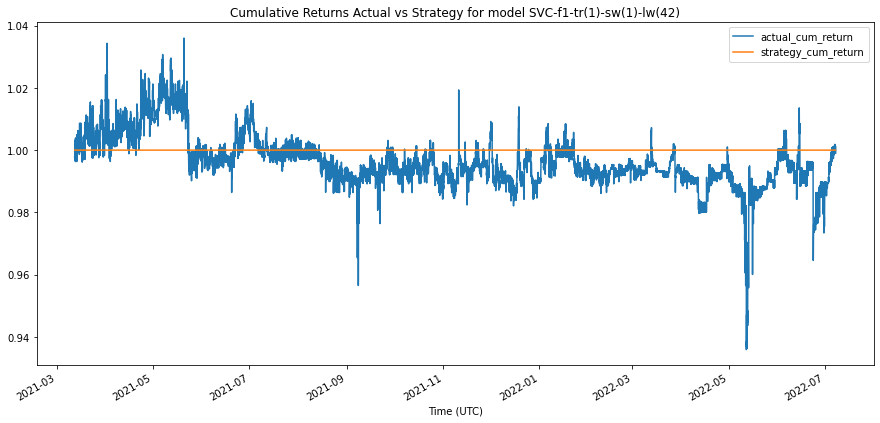

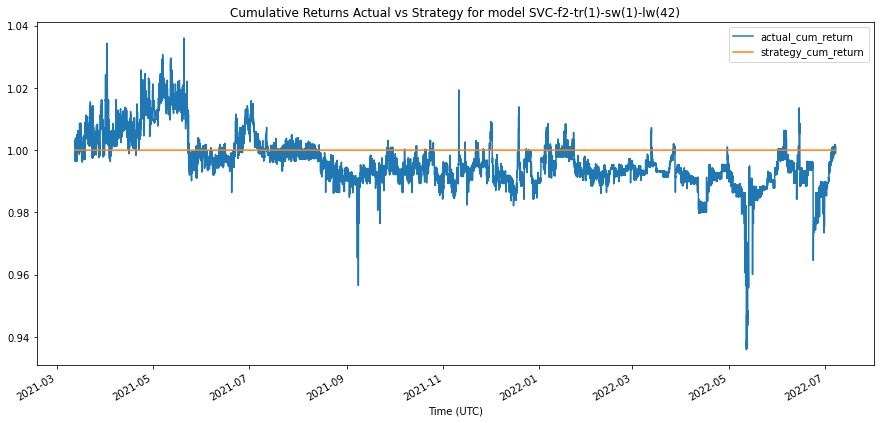

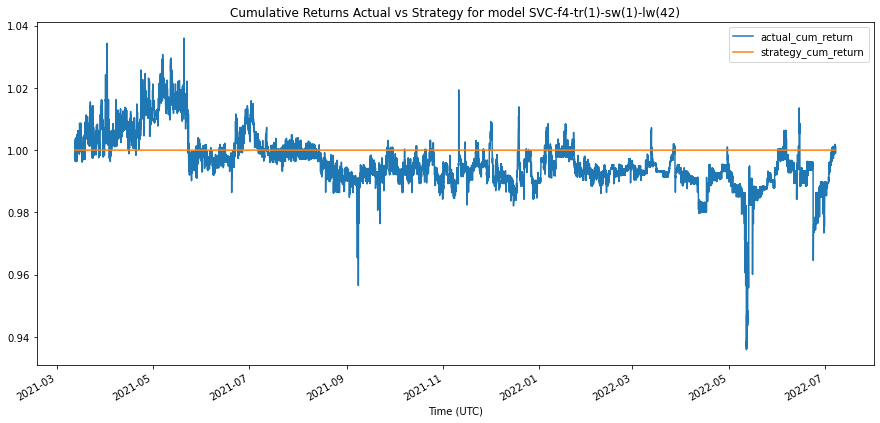

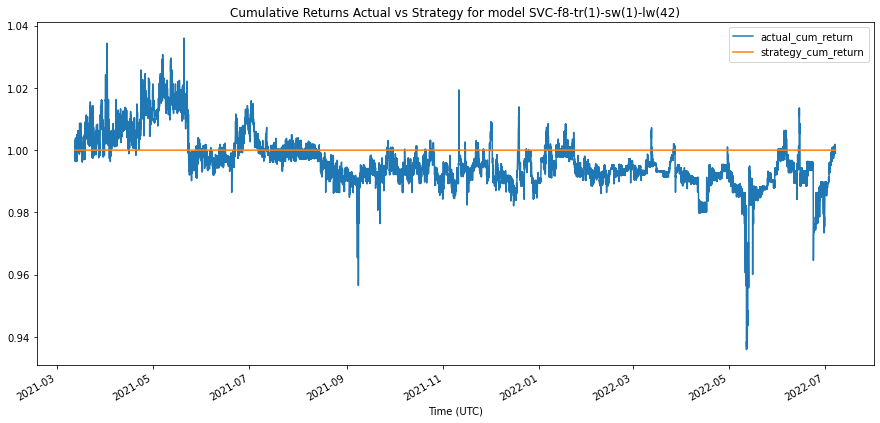

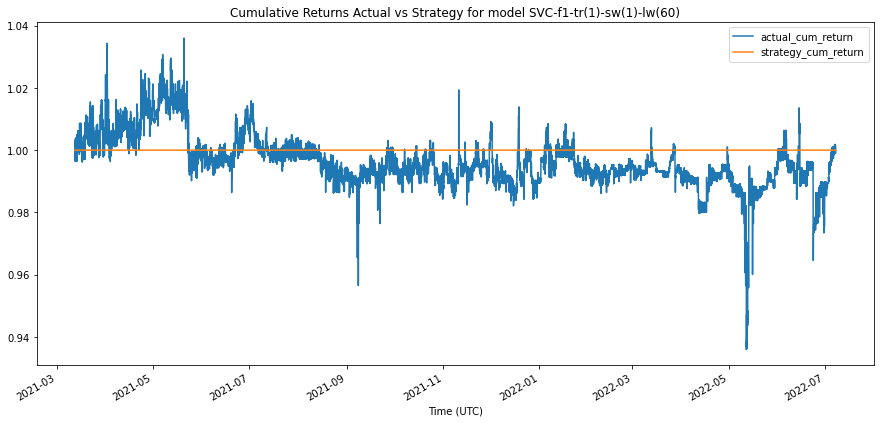

...

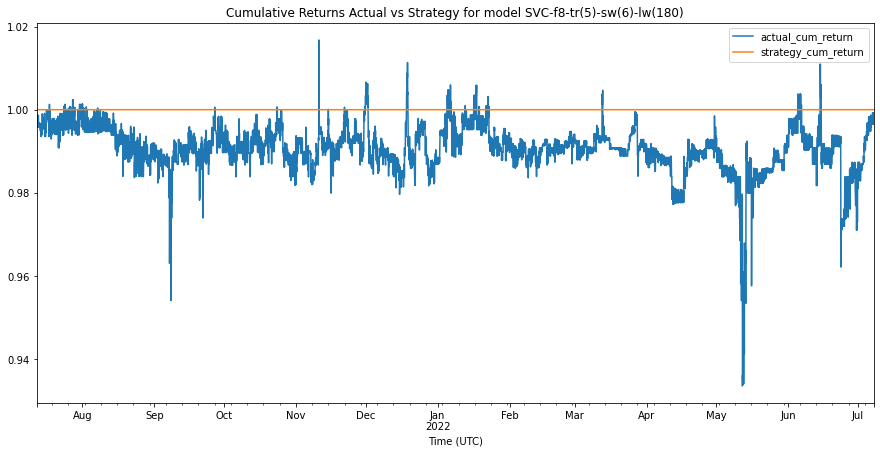

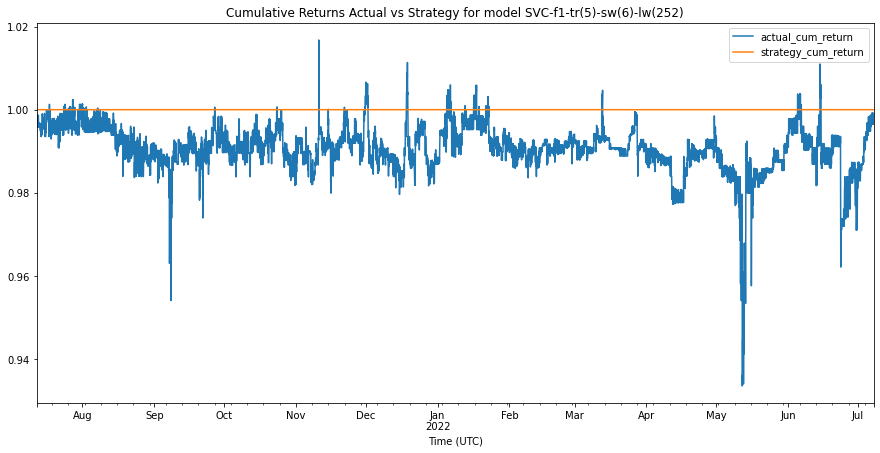

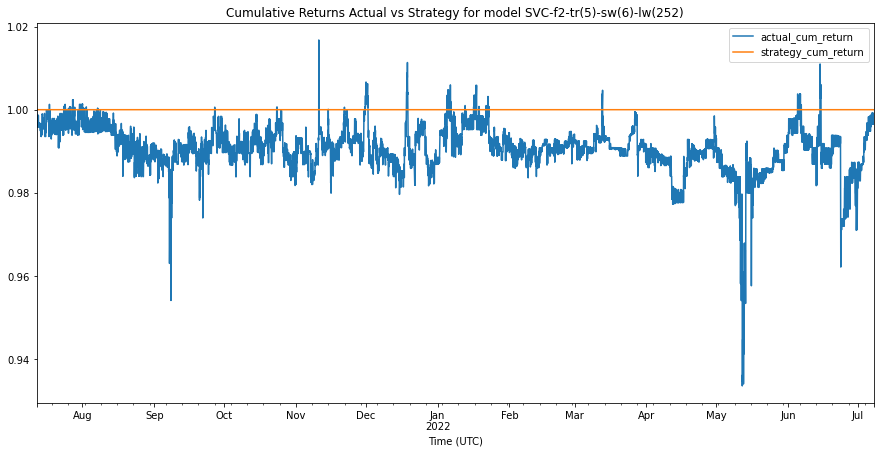

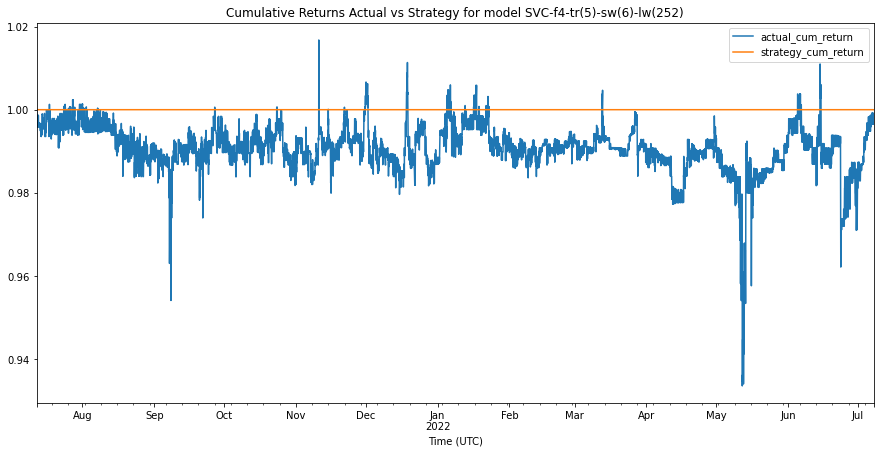

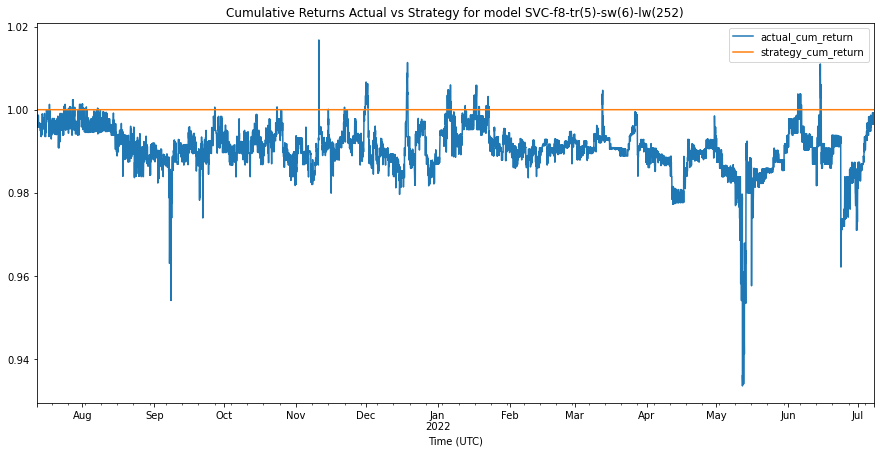

In [8]:
# main loop
# TODO: Modify to fit data and looping needs

models = {}
max_return = None
selected_model = None

# construct the model permutations and evaluate the model permutations
for name in alternate_models:
    returns = None
    max_return = 0
    selected_model = None
    for training_months in training_dataset_months:
        for fast_sma_window in short_window_sizes:
            for slow_sma_window in long_window_sizes:
                for period in periods:
                    for factor in factors:
                        # create a key for this model permutation
                        model_key = f"{name}-f{period}-tr({training_months})-sw({fast_sma_window})-lw({slow_sma_window})"

                        # configure model permutation
                        models[model_key] = {
                            "model_name":name,
                            "training_months":training_months,
                            "fast_sma_window":fast_sma_window,
                            "slow_sma_window":slow_sma_window,
                            "model":alternate_models[name]["model"],
                        }

                        # get source data, for each source data, get engineered features
                        datasets = []
                        for source in sources:
                            df = None
                            if source['provider']=='cryptocompare':
                                df = get_cryptocompare_data(source['path'])
                            elif source['provider']=='kucoin':
                                df = get_kucoin_data(source['path'])

                            # add engineereg features derived from ohlcv
                            df = add_engineered_features(df,fast_sma_window,slow_sma_window)

                            # prefix column names so they can be differentiated
                            cols = df.columns
                            new_cols = []
                            for col in cols:
                                new_cols.append(f"{source['label']}_{col}")                                        
                            df.columns=new_cols

                            datasets.append(df)
                            # df = df.add_class_labels(df,slow_sma_window,factor,period)

                        df = pd.concat(datasets,axis=1)

                        df = add_class_labels(df,std_window,factor,period)
                        
                        df['returns'] = df['sUSD/USDT_close'].pct_change()

#                         Dealing with class imbalance
#                         Read the data

#                         Visualize the data

#                         Split the data into training and testing sets

#                         Oversample the data

#                         Fit a model

#                         Make predictions

#                         Evaluate the model

                        # create training and testing datasets
                        models[model_key]['X_train_scaled'], models[model_key]['y_train'], models[model_key]['X_test_scaled'], models[model_key]['y_test'], models[model_key]['x_scaler'] = create_train_test_datasets(training_months,df)

                        # **********************************************************
                        # use random oversampling to address class imbalance
                        random_oversampler = RandomOverSampler()
                        print(f"value counts before resampling: \n{models[model_key]['y_train'].value_counts()}")
                        models[model_key]['X_train_scaled'], models[model_key]['y_train'] = random_oversampler.fit_resample(models[model_key]['X_train_scaled'], models[model_key]['y_train'])            
                        print(f"value counts after resampling: \n{models[model_key]['y_train'].value_counts()}")
                        # **********************************************************
            
                        # train model
                        models[model_key]['trained_model'] =  models[model_key]['model'].fit(models[model_key]['X_train_scaled'], models[model_key]['y_train'])

                        # get predictions
                        y_predictions = models[model_key]['trained_model'].predict( models[model_key]['X_test_scaled'])
                        print(f"# of y_test: {len(models[model_key]['y_test'])}    # of predictions: {len(y_predictions)}")
                        models[model_key]['y_predictions'] = pd.DataFrame(
                            {
                                "y_test":models[model_key]['y_test'],
                                "y_prediction":y_predictions,
                                "Actual Returns":df.loc[models[model_key]['y_test'].index.min():models[model_key]['y_test'].index.max():,'returns']
                            })
                        display(models[model_key]['y_predictions'])
                        models[model_key]['y_predictions'].dropna()
                        

                        # Classification reports
                        models[model_key]['classification_report'] = classification_report(models[model_key]['y_predictions']['y_test'], models[model_key]['y_predictions']['y_prediction'])

                        # Print the classification report
                        print(f"""
                        {model_key} classification report: 
                        ---------------------------------------------------------------------------
                        {models[model_key]['classification_report']}
                        ---------------------------------------------------------------------------
                        """)          
                        
                        # models[model_key]['confusion_matrix'] = confusion_matrix(models[model_key]['y_test'], models[model_key]['y_predictions'])
                        # display(models[model_key]['confusion_matrix'])

                        # backtest model
                        models[model_key]['backtest'] = backtest_model(
                            model_key,
                            models[model_key]['y_predictions']
                        )   

                        # add the cumulative return to the list of returns for plotting
                        # add the actual and signal returns if the 
                        if returns is None:
                            # This is the permutation for the model
                            # create the returns dataframe and add the actual returns and the signal returns
                            returns = {
                                "actual": (1 + df['returns']).cumprod(),
                                # "strategy": (1 +models[model_key]['backtest']['Strategy Returns']).cumprod()
                            }
                        returns[model_key] = models[model_key]['backtest']['strategy_cum_return']
                        if returns[model_key].iloc[-1] > max_return:
                            max_return = returns[model_key].iloc[-1]
                            selected_model = model_key
                    
    # create a plot for the family of returns for the range of training monts, and SMA window sizes
    returns_df = pd.DataFrame(returns)
    model_family_plot = returns_df.plot(
        figsize=(15,15),
        title=f'{name} Cumulative Returns for various training and SMA window sizes'
    )
    
#     # save plot
#     model_family_plot.figure.savefig(f'images/{name}_returns.png', bbox_inches='tight')

    # show the final returns for the family
    display(returns_df.iloc[-1:,:].T)

    # show the max return achieved with the model
    print(f"maximum cumulative return for {name} models was {max_return} from model permutation {selected_model}")